# Puzzle Companion

## Background 

I'd like to show the methods I used for making progress on a puzzle I've had laying on a table for three months and was getting frustrated over the lost space and clutter. It's worked out reasonably well and I'll share my files on GitHub for anyone who wants to use them as well. 

## Goal
I wanted to see if it would be possible to match pictures of individual puzzle pieces to the larger solution board automatically. I ended up using a variety of methods and finished with a hybrid that worked well. 

<img src ="BobaBox.png" width = "500">

### Getting the puzzle piece image

When capturing the puzzle piece, I took a relatively straight-on photo with my phone and for each image immediately cropped the image to just the piece leaving a little background. I also experimented with cropping to just the interior of some pieces but although this eliminated some false positives, it also removed a lot of edge features that could have been useful in matching. Finally, I tried to take images in good lighting (no flash-too much glare) and minimize the reflections off the pieces. These photos were synced over dropbox and icloud to locations where my program could immediately access them. 

### Getting the solution image

First, I needed a good image to compare the individual puzzle pieces. I initially tried [amazon](https://www.amazon.com/Star-Wars-Photomosiac-Jigsaw-Puzzle/dp/B00OMVQE44/). Unfortunately, Amazon doesn't allow you to directly right-click and save images from the page *but* since they provide zoomed in images when you mouseover an image, I knew the sources existed. 

So I viewed the page's source (Ctrl-U or right click-> View Page Source) and searched for any hyperlinks that had hires

The first:
<img src="https://images-na.ssl-images-amazon.com/images/G/01/VANS/Q12019/0211_312_FTV_Q1_02112Deliverables_WMS_ilm_desktop_2x._CB454111781_.jpg">

Nope, not what I wanted. 

But the second was more successful:
<img src = "https://images-na.ssl-images-amazon.com/images/I/91-lOWBN%2BsL._SL1500_.jpg">

A little investigation shows the image is 1108 x 1500 pixes. Not bad but nowhere near the resolution that would allow us to see fine details in the individual mosaic photos. 

I also reached out to the puzzle maker buffalo games customer service to see if they'd respond to a request for a high-resolution image but they never got back to me. 

## Getting a hi-res version of the solution image

Thankfully, the puzzle itself comes with a printed solution image of A3 size (equivalent of two standard 8.5x11" sheets). One can make out very fine details in the image which is incredibly helpful. I took that image to my scanner and ramped up the scanner to the highest density and scanned the bottom and top of the image. Despite my best efforts, I wasn't able to keep the image perfectly straight and it ended up being about 10 pixels shifted from top to bottom. Given it's a 4000+ pixel height, that's only .15 degrees off but it would impact some performance. 

<img src = "BobaFettHiRes.jpg">

## Transforming the solution

An unfortunate side effect of the scanning was that I also cut part of the middle slice of photos off and didn't realize it until midway through the process. During the next transform, I also adjusted the middle with black just so the spacing would be uniform and I'd visually be able to tell when there wasn't information about part of the image. 

I needed to find the transform of the original hi-res image to a square image and for this, we turn to a homography transform - time for some actual code!


In [2]:
#Needed libraries
#Standard data manipulation and display libraries
import numpy as np #Workhorse of the data manipulations
import pandas as pd #Will be needed for some 
from matplotlib import pyplot as plt

#Various utilities
import math #calcuting distances between points
from itertools import compress #single use for matching bools
import re # for renaming the solution images so we can retain original name and save a hi-res version of the solution

import cv2 as cv #This needs to be 3.4.1!! Based on stackoverflow, I used "conda install -c menpo opencv" to install 3.4.1

from sklearn.cluster import KMeans 
from sklearn.metrics import silhouette_score
from sklearn.cluster import AffinityPropagation

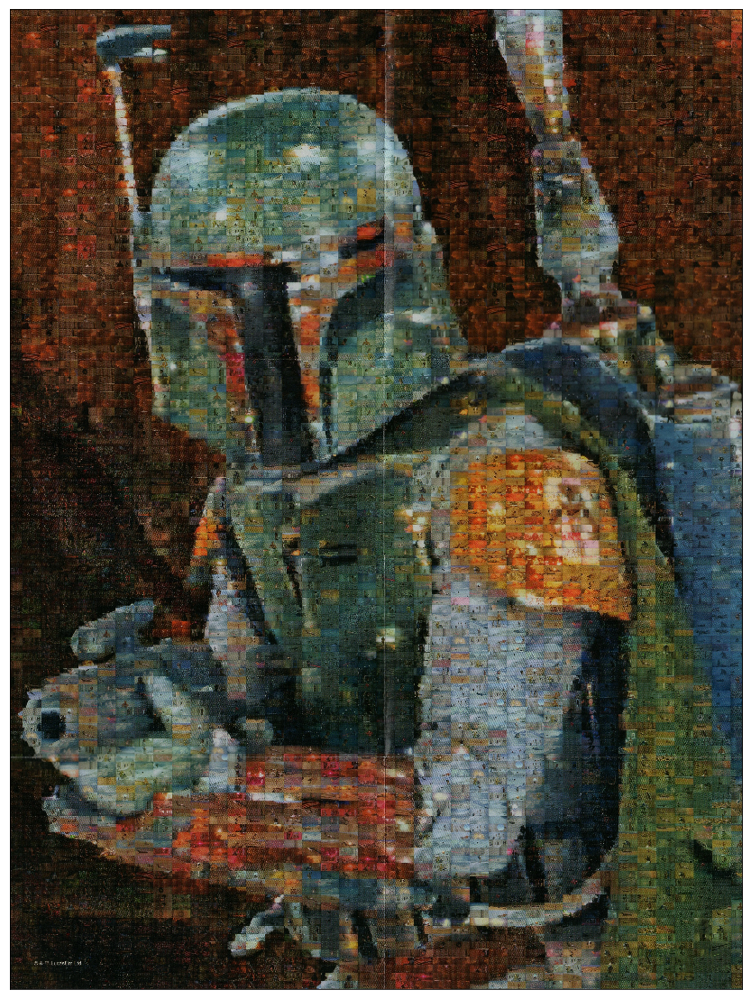

In [3]:
## Transform hi res images to square
canvas = 'BobaFettHiRes.jpg'
puzzle = cv.imread(canvas)
tiles_high = 125
tiles_wide = 38
# 4 corner points of the bounding box
source_points = np.array([[8,8], [3263,13], [18, 4387],[3273, 4381]])
new_height = round((4381-13)/tiles_high)*tiles_high 

new_width = round((3273-18)/tiles_wide)*tiles_wide

# 4 corner points of the black image you want to impose it on
new_corners = np.array([[0,0],[new_width, 0],[ 0,new_height],[new_width, new_height]])

#---- forming the black image of specific size
new_blank = np.zeros((new_height, new_width, 3), np.uint8)

#---- Framing the homography matrix
h, status = cv.findHomography(source_points, new_corners)

#---- transforming the image bound in the rectangle to straighten
straightened_image = cv.warpPerspective(puzzle, h, (new_blank.shape[1],new_blank.shape[0]))
cv.imwrite("HiResStraightened.jpg", straightened_image)
plt.figure(figsize = (30, 20))

#Note: opencv codes colors in BGR order whereas matplotlib's pyplot expect RGB
#Anywhere in this notebook where I'm using matplotlib I'll add the [...,::-1] to reverse the last element and display correctly
plt.imshow(straightened_image[...,::-1]) 
plt.xticks([]), plt.yticks([]), 
plt.show() 

# Template Matching

The first attempt to match the puzzle pieces were based on matching exact copies of the photo to the solution board. 

## Example:

This piece: 
<img src = IMG_0277_inside.jpg width = "200">

should be found here:

<img src = inside_match.jpg width = "600">

The first attempt to find the location was using template matching. This method tries to find an exact replica of the small photo within the general scene and as we'll see isn't very robust. 

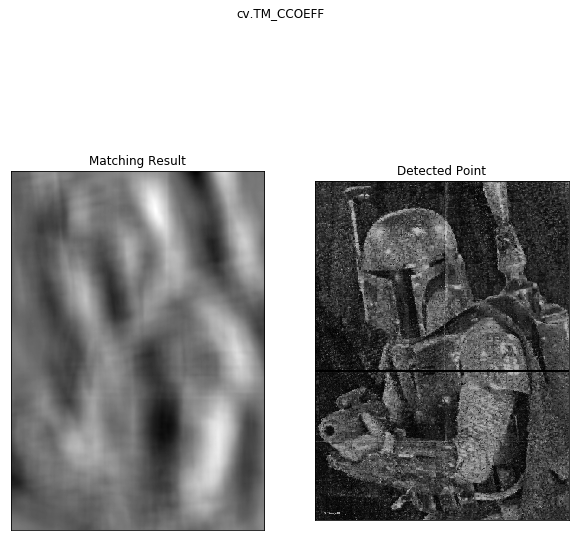

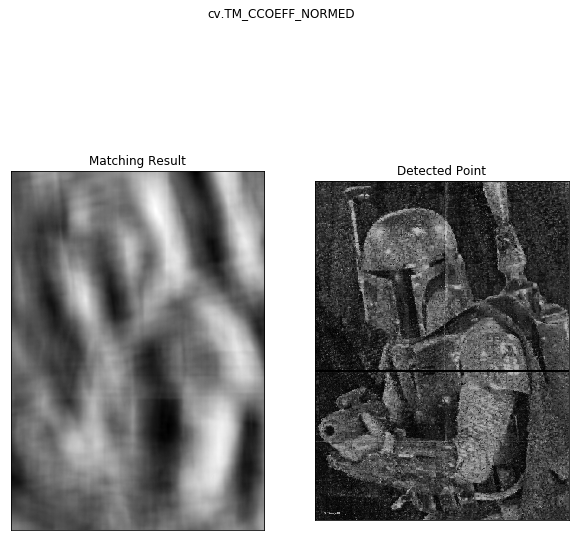

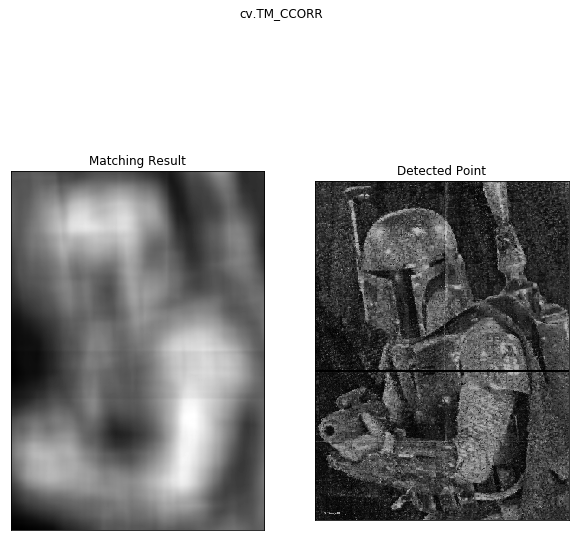

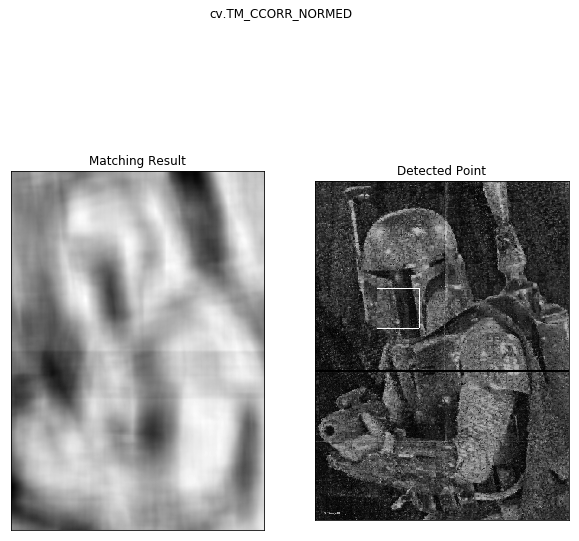

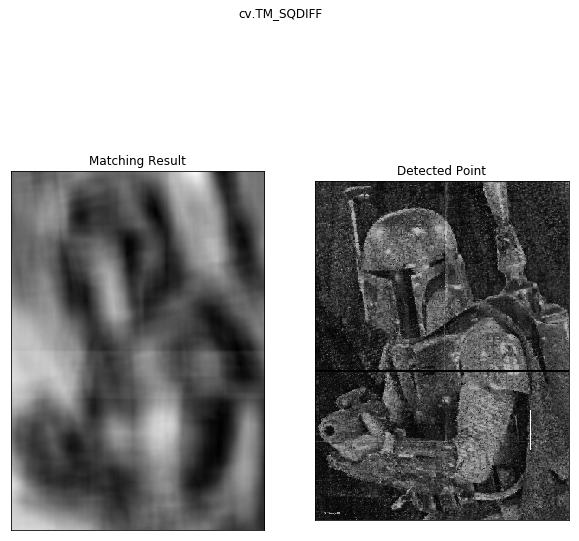

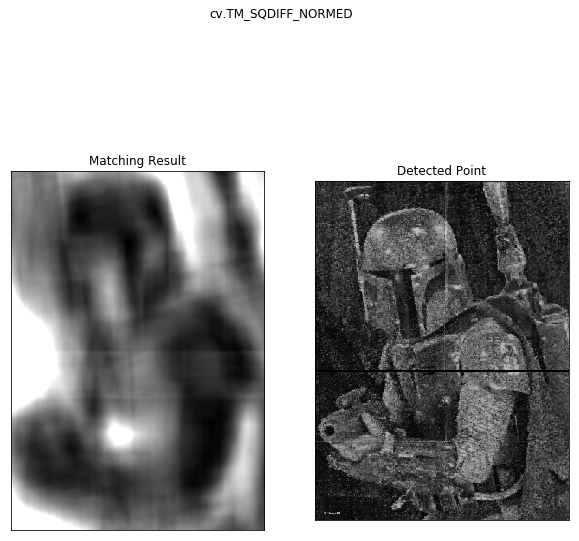

In [4]:
## Template Matching method

img_base = cv.imread('gap.jpg',0)
template = cv.imread('IMG_0277_inside.jpg',0)
w, h = template.shape[::-1]

# All the 6 methods for comparison in a list
methods = ['cv.TM_CCOEFF', 'cv.TM_CCOEFF_NORMED', 'cv.TM_CCORR',
            'cv.TM_CCORR_NORMED', 'cv.TM_SQDIFF', 'cv.TM_SQDIFF_NORMED']

for meth in methods:
    img = img_base.copy() #copy for editing
    method = eval(meth) #translate string to command
 
    # Apply template Matching
    res = cv.matchTemplate(img,template,method)
    min_val, max_val, min_loc, max_loc = cv.minMaxLoc(res)

    # If the method is TM_SQDIFF or TM_SQDIFF_NORMED, take minimum
    if method in [cv.TM_SQDIFF, cv.TM_SQDIFF_NORMED]:
        top_left = min_loc
    else:
        top_left = max_loc
    bottom_right = (top_left[0] + w, top_left[1] + h)

    cv.rectangle(img,top_left, bottom_right, 255, 2)
    plt.figure(figsize = (10,10))
    plt.subplot(121),plt.imshow(res,cmap = 'gray')
    plt.title('Matching Result'), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(img,cmap = 'gray')
    plt.title('Detected Point'), plt.xticks([]), plt.yticks([])
    plt.suptitle(meth)

    plt.show()


So we only got one match and that wasn't in the right spot. But that square is pretty large so what if we downsize the cropped image? 

Breakout the old paint and use the resize tool, measure the answer location on gap.jpg (~110x110 pixels) and try again:


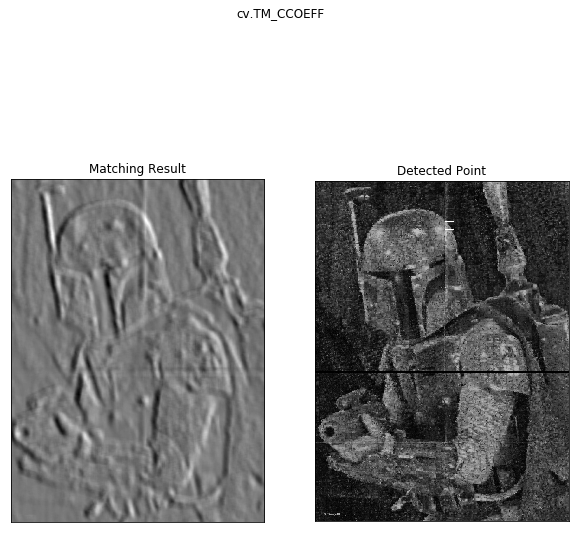

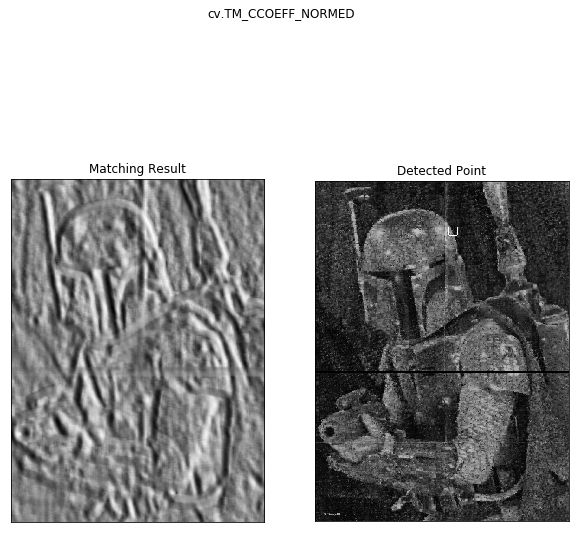

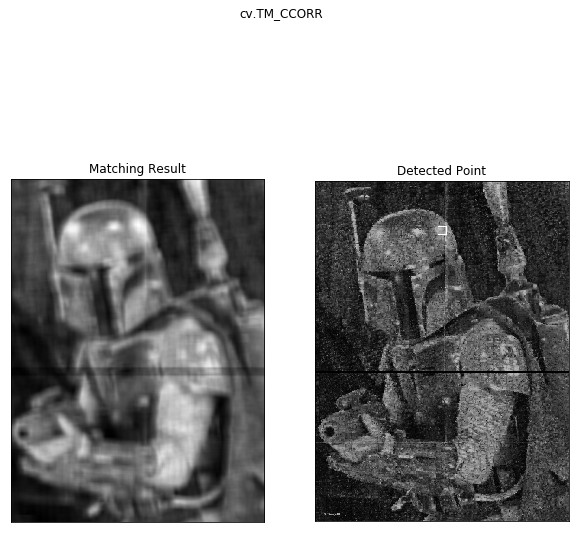

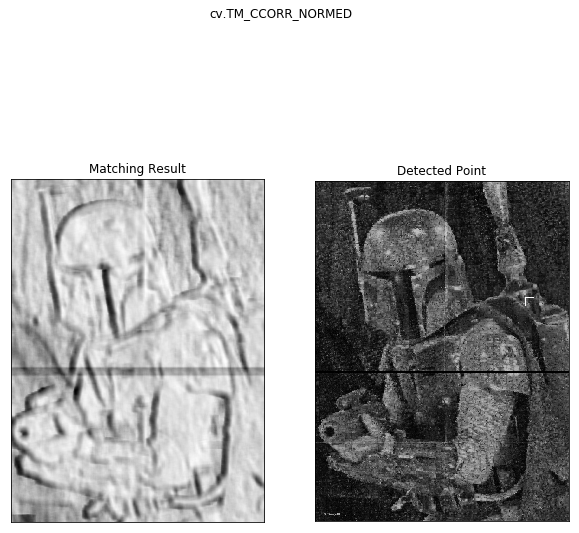

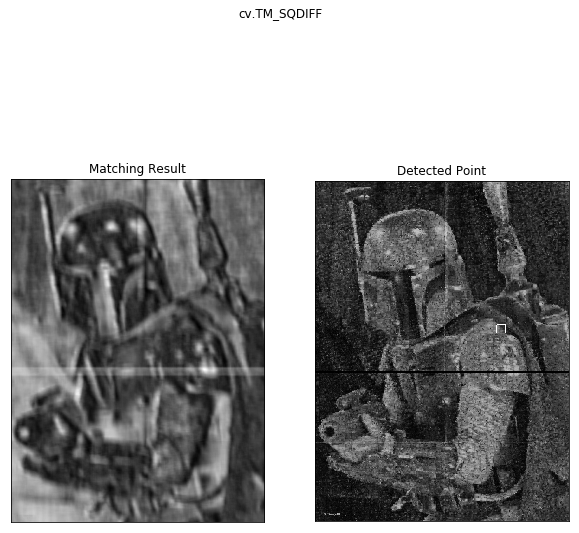

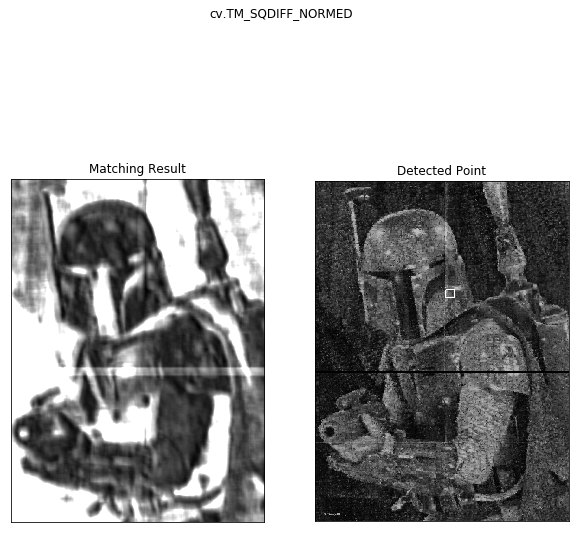

In [5]:
## Template Matching method

img_base = cv.imread('gap.jpg',0)
template = cv.imread('inside_downsized.jpg',0)
w, h = template.shape[::-1]

# All the 6 methods for comparison in a list
methods = ['cv.TM_CCOEFF', 'cv.TM_CCOEFF_NORMED', 'cv.TM_CCORR',
            'cv.TM_CCORR_NORMED', 'cv.TM_SQDIFF', 'cv.TM_SQDIFF_NORMED']

for meth in methods:
    img = img_base.copy() #copy for editing
    method = eval(meth) #translate string to command
 
    # Apply template Matching
    res = cv.matchTemplate(img,template,method)
    min_val, max_val, min_loc, max_loc = cv.minMaxLoc(res)

    # If the method is TM_SQDIFF or TM_SQDIFF_NORMED, take minimum
    if method in [cv.TM_SQDIFF, cv.TM_SQDIFF_NORMED]:
        top_left = min_loc
    else:
        top_left = max_loc
    bottom_right = (top_left[0] + w, top_left[1] + h)

    cv.rectangle(img,top_left, bottom_right, 255, 8)
    plt.figure(figsize = (10,10))
    plt.subplot(121),plt.imshow(res,cmap = 'gray')
    plt.title('Matching Result'), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(img,cmap = 'gray')
    plt.title('Detected Point'), plt.xticks([]), plt.yticks([])
    plt.suptitle(meth)

    plt.show()


So regardless of our preprocessing, the template matching doesn't seem to be working very well. It gave some places the piece might have been ok, but it never actually got the correct answer. Let's move on to ORB matching.

# Using ORB Matching

ORB or (Oriented FAST and Rotated BRIEF). ORB was created from the labs of openCV as an alternative to the patented SIFT or SURF algorithms but ORB is not. The benefits of these three algorithms are that they are supposed to be more robust to size (especially important in this case) and rotation indifferent.

I used the orb algorithm from openCV to try to match feature points. The results were very variable. 
Here's an example of the features it would find: 

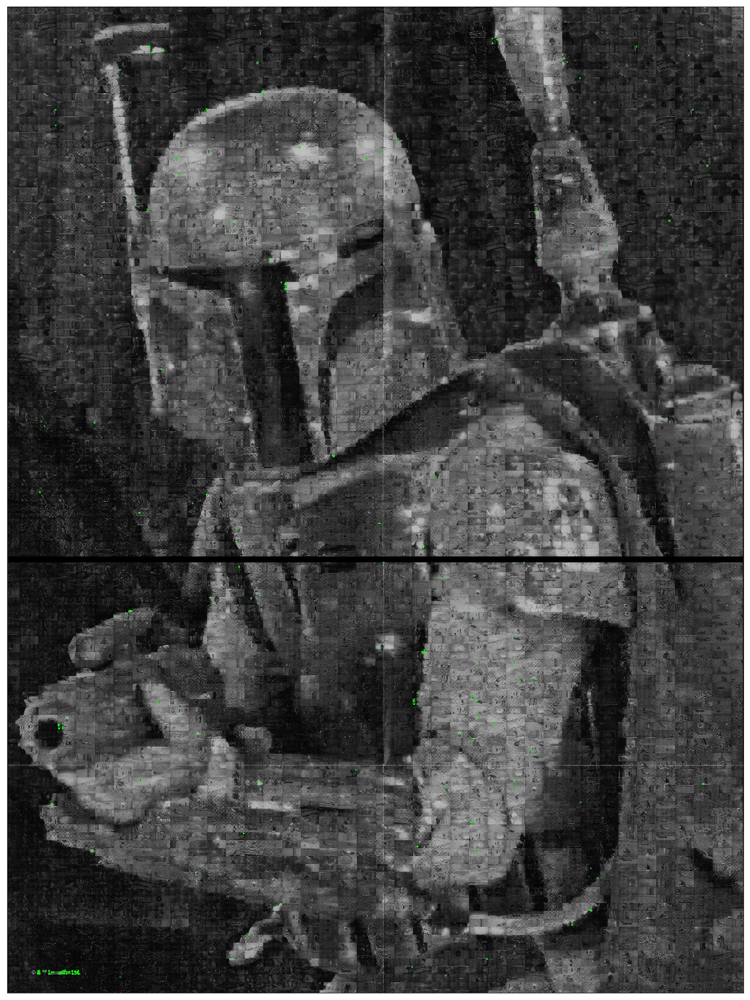

In [6]:
img = cv.imread('gap.jpg',0) #grayscale (0) is better for feature detection
# Initiate ORB detector
orb = cv.ORB_create()
# find the keypoints with ORB
kp = orb.detect(img,None)
# compute the descriptors with ORB
kp, des = orb.compute(img, kp)
# draw only keypoints location,not size and orientation
img2 = cv.drawKeypoints(img, kp, None, color=(0,255,0), flags=0)
plt.figure(figsize = (20,30))
plt.imshow(img2)
plt.xticks([]), plt.yticks([]), 
plt.show()

When this was used to match to puzzle pieces, it would often produce results such as these:

In [7]:
def FlannMatcher(piece, canvas):
    #%% brute force orb FlannBasedMatcher
    img1 = cv.imread(piece,0)
    img2 = cv.imread(canvas,0) 
    c_img1 = cv.imread(piece,1)
    c_img2 = cv.imread(canvas,1) 
    # Initiate ORB detector
    orb = cv.ORB_create()

    #various settings to experiment with-didn't make a difference in performance. 
    #orb.getPatchSize()
    #orb.getNLevels()
    #orb.getScaleFactor()
    #orb.getEdgeThreshold()
    ##orb.setScaleFactor(1.1)
    #orb.setNLevels(30)
    #orb.setWTA_K(4)

    # find the keypoints and descriptors with ORB
    kp1, des1 = orb.detectAndCompute(img1,None)
    kp2, des2 = orb.detectAndCompute(img2,None)

    # create BFMatcher object
    bf = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=True)
    # Match descriptors.
    matches = bf.match(des1,des2)
    # Sort them in the order of their distance.
    matches = sorted(matches, key = lambda x:x.distance)
    # Draw  matches 
    img3 = cv.drawMatches(c_img1,kp1,c_img2,kp2,matches[:min(20,len(matches))],None,flags=2)
    plt.figure(figsize = (20,30))
    plt.imshow(img3[...,::-1]),
    plt.xticks([]), plt.yticks([])
    plt.show()
    return

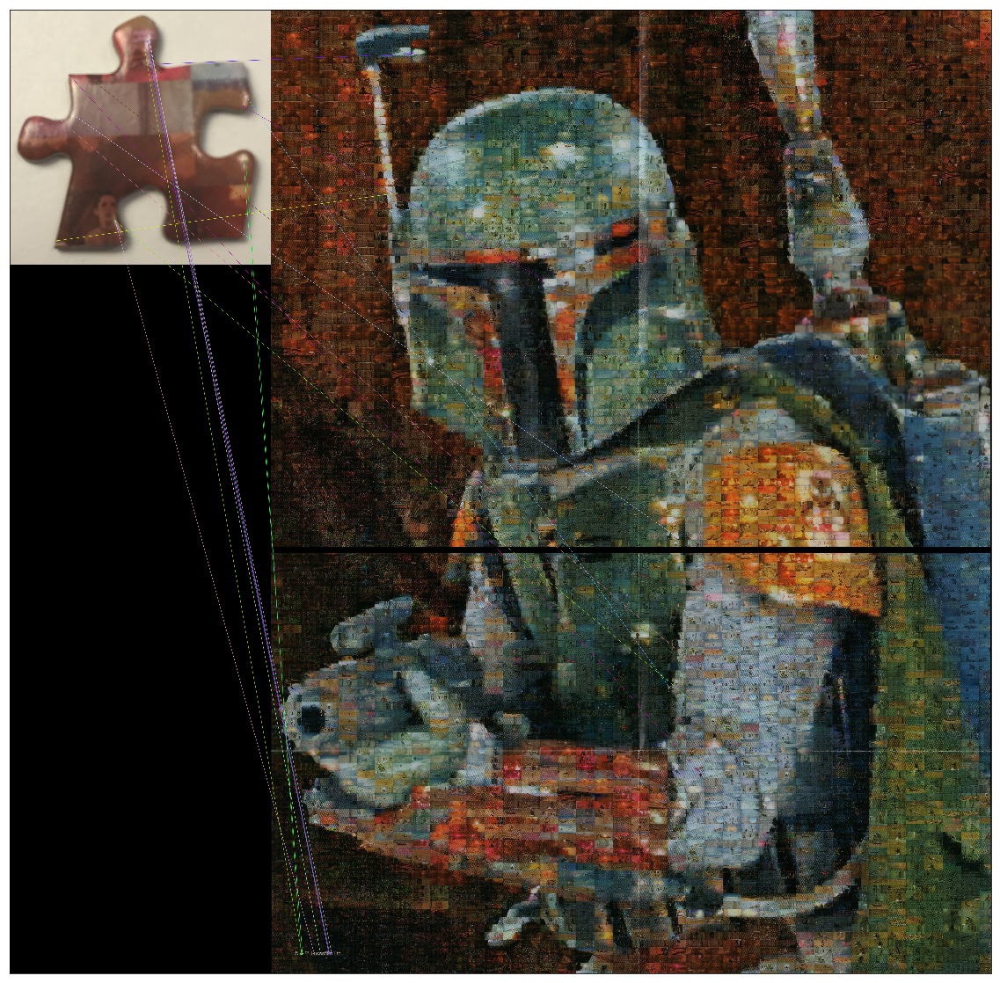

In [8]:
FlannMatcher('IMG_0286.jpg', 'gap.jpg')

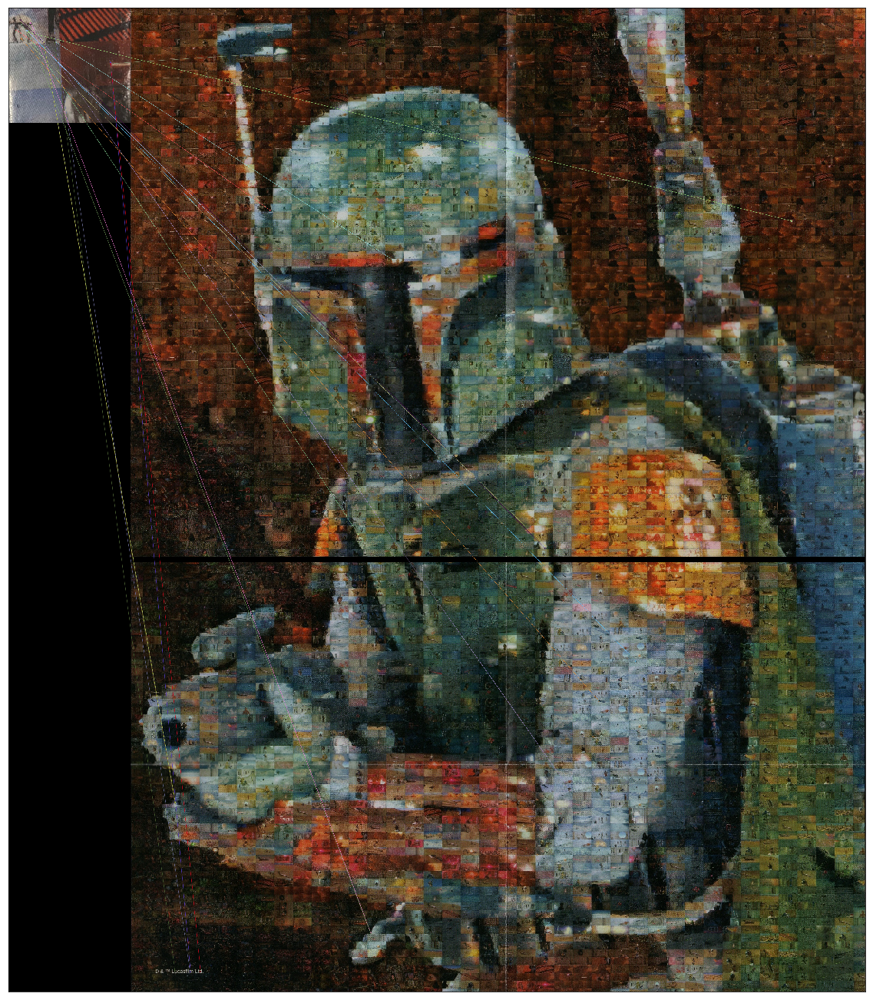

In [9]:
FlannMatcher('IMG_0277_inside.jpg', 'gap.jpg')

I tried fiddling with many parameters of the matching algorithm, lighting the pieces in different ways, cropping to just the interior of the piece but I think the match algorithm kept getting confused that the pieces have matches all over the image and it just matches it to the absolute best one which could be totally random based on the compression used on the jpg images and how it affects individual instances of the same tiles.

I also tried the SIFT algorithm which produced cool photos like this showing marker locations, size and orientations, but didn't do any better with the matching results

<img src = "0286_Sift_solution.jpg">

---


On the occasions where we did have the location of the piece, I needed a system to be able to place each piece and not lose track of where it went on the final puzzle. This has actually turned out to be the biggest step improvement of the puzzle-solving process. Regardless of the algorithm used to match, we absolutely needed a better way to keep track of the solved pieces and not lose them once we knew where they went. This required a grid:

# Creating the grid

In this same repository, you should find an excel sheet that was meant to be printed for a 27x20" puzzle but may need to be adjusted based on how your printer settings are setup. The grids in that sheet correspond to the rows and columns in the above image's gridlines. Once the piece has been located in the larger solution, it can be placed on the grid and kept there waiting for other pieces to slowly surround it. 

Here's the code to create the grid overlay on the hi res solution image- the fonts available for openCV seem to be very limited and at the sizes I needed it could be difficult to tell some of the number apart but the code still works great. 


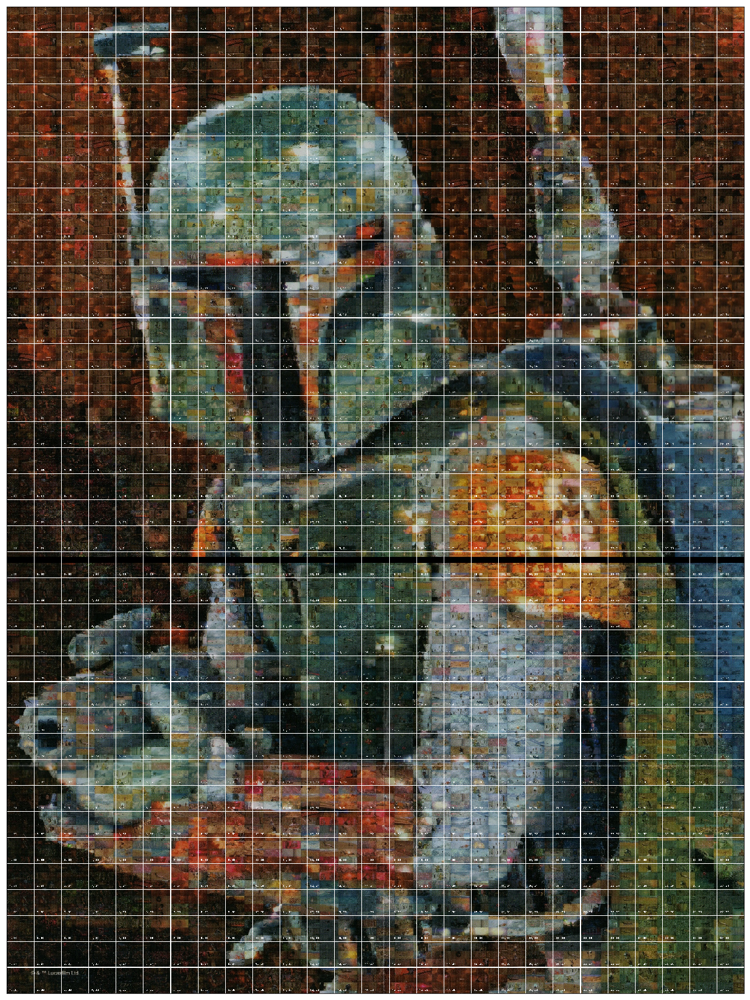

In [10]:
#For the grid, we have to know the number of pieces that are the height and width
scene_color = cv.imread('gap.jpg')
horizantal_pieces = 27 #number of actual puzzle pieces across- found by completing the edges of the puzzle
vertical_pieces = 38  #same as above but for height, I believe these are fairly standard for this size puzzle

h_width = scene_color.shape[1]/horizantal_pieces
v_width = scene_color.shape[0]/vertical_pieces

#Draw horizantal and vertical lines for better placement
for i in range(1, horizantal_pieces):
    cv.line(scene_color, (int(i*h_width), 0), (int(i*h_width), scene_color.shape[0]), (255,255,255), 2)
for i in range(1, vertical_pieces):
    cv.line(scene_color, (0, int(i*v_width)), (scene_color.shape[1], int(i*v_width)), (255,255,255), 2)

#label cells
for h in range(1, horizantal_pieces+1):
    for v in range(1, vertical_pieces+1):
        cv.putText(scene_color, f'{h}, {v} ', \
        (int((h-.9)*h_width), int((v-.1)*v_width)), cv.FONT_HERSHEY_PLAIN, .75, (255,255,255))
cv.imwrite('hv_lines.jpg', scene_color)
plt.figure(figsize = (30,30))
plt.imshow(scene_color[...,::-1])
plt.xticks([]), plt.yticks([])
plt.show()

# Using SURF (Speeded Up Robust Features) plus clustering


The best result I had actually did give the position of the piece:

<img src="best_yet.jpg">

This was using the SURF algorithm which turned out to be relatively quick at performing the calculations. However, it would typically give similar results as the above ORB where a lot of false positives would track all over the solution photo. 

However, contrary to my experiences with ORB, the SURF method would oftentimes have actual matches to the correct location along with a lot of false positives. Based on this feature, I thought it would be useful to provide possible locations by clustering the solution points, and if a cluster had points within a set distance and had a minimum number of matching points, I could draw a box around it and I could match those prime possible locations myself. This turned out to be a very robust solution. 


I'm grateful to the openCV documentation [here](https://docs.opencv.org/3.0-beta/doc/py_tutorials/py_feature2d/py_matcher/py_matcher.html) that directed a lot of my experimentation. 



In [11]:
canvas = 'gap.jpg'
piece = 'IMG_0277_inside.jpg'
def best_image(canvas, piece, Hessian_distance = 400, threshold_distance = 50, num_points =2):
    scene_color = cv.imread(canvas)
    piece_color = cv.imread(piece)
    horizantal_pieces = 27 #number of actual puzzle pieces across- found by completing the edges of the puzzle
    vertical_pieces = 38  #same as above but for height, I believe these are fairly standard for this size puzzle
    
    h_width = scene_color.shape[1]/horizantal_pieces
    v_width = scene_color.shape[0]/vertical_pieces

    #Draw horizantal and vertical lines for better placement
    for i in range(1, horizantal_pieces):
        cv.line(scene_color, (int(i*h_width), 0), (int(i*h_width), scene_color.shape[0]), (255,255,255), 2)
    for i in range(1, vertical_pieces):
        cv.line(scene_color, (0, int(i*v_width)), (scene_color.shape[1], int(i*v_width)), (255,255,255), 2)
    #label cells
    for h in range(1, horizantal_pieces+1):
        for v in range(1, vertical_pieces+1):
            cv.putText(scene_color, f'{h}, {v} ', \
            (int((h-.9)*h_width), int((v-.1)*v_width)), cv.FONT_HERSHEY_PLAIN, .75, (255,255,255))
    #scene_color will be re-used when drawing the matches but is ignored for actual matching
    #For matching, we'll use grayscale
            
    img_object = cv.imread(piece, cv.IMREAD_GRAYSCALE)
    img_scene = cv.imread(canvas, cv.IMREAD_GRAYSCALE)
    if img_object is None or img_scene is None:
        print('Could not open or find the images!')
    #-- Step 1: Detect the keypoints using SURF Detector, compute the descriptors
    minHessian = Hessian_distance
    surf = cv.xfeatures2d_SURF.create(hessianThreshold=minHessian)

    #surf.setUpright(True)
    #surf.setExtended(True) # These were attempt to say the pieces were upright but didn't affect performance

    keypoints_obj, descriptors_obj = surf.detectAndCompute(img_object, None)
    keypoints_scene, descriptors_scene = surf.detectAndCompute(img_scene, None)
    #-- Step 2: Matching descriptor vectors with a FLANN based matcher
    # Since SURF is a floating-point descriptor NORM_L2 is used
    print(f"In the object and scene, found {len(keypoints_obj)} and {len(keypoints_scene)} keypoints respectively")
    FLANN_INDEX_KDTREE = 0
    index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
    search_params = dict(checks = 50)

    flann = cv.FlannBasedMatcher(index_params, search_params)
    
    #SURF uses k-nearest-neighbors for matching the descriptors
    knn_matches = flann.knnMatch(descriptors_obj,descriptors_scene,k=2)

    #-- Filter matches using the Lowe's ratio test
    ratio_thresh = 0.90
    good_begin = []
    for m,n in knn_matches:
        if m.distance < ratio_thresh * n.distance:
            good_begin.append(m)

    list_keypoints = [keypoints_scene[mat.trainIdx].pt for mat in good_begin]

    xy_points = np.array([[x, y] for x,y in list_keypoints])

    threshold_distance = threshold_distance
    num_points = num_points

    #create a dataframe for indexing all the good points so far and we'll perform clustering there
    #we'll compare each good_match point to every other and determine the distance to each other point
    named_pts = pd.DataFrame()
    for index, pt in enumerate(xy_points):
        named_pts['i'+str(index)] = pd.DataFrame(xy_points, columns = ['x', 'y']).apply(lambda row: math.hypot(row.x-pt[0], row.y-pt[1]), axis = 1)
    
    #We have a grid of distances, apply a filter of points who meet the criteria
    #apply the filters of threshold_distance and number of points
    good_bool = list((named_pts < threshold_distance).sum()>num_points)
    #apply the boolean logic to the original list of matches to get the filtered and eliminate the weird indexes
    good_matches = list(compress(good_begin, good_bool))
    print(f"Got {((named_pts < threshold_distance).sum()>num_points).sum()} good matching points")
    if ((named_pts < threshold_distance).sum()>num_points).sum() < 2:
        return
    final_keypoints = (pd.DataFrame([keypoints_scene[mat.trainIdx].pt for mat in good_matches]).drop_duplicates()).values.tolist()
    
    #we don't know how many clusters we're going to use so I'm using the silhouette score
    #to choose the number of clusters with the highest score. 
    
    #Probably could have used affinity clustering on this one as well. 
    silhouette = 0 #initial score to beat
    n_clusters = 2 #minimum number of clusters
    
    #max number of clusters is the number of keypoints minus 2
    for clusters in range(2,len(final_keypoints)-2):
        km = KMeans(n_clusters=clusters)
        alldistances = km.fit_transform(final_keypoints)
        if silhouette_score(final_keypoints, km.labels_) > silhouette:
            n_clusters = clusters
            silhouette = silhouette_score(final_keypoints, km.labels_)
    km = KMeans(n_clusters=n_clusters)
    alldistances = km.fit_transform(final_keypoints)
    (pd.DataFrame(final_keypoints).drop_duplicates()).values.tolist()
    
    #-- Draw matches
    img_matches = np.empty((max(piece_color.shape[0], scene_color.shape[0]), piece_color.shape[1]+scene_color.shape[1], 3), dtype=np.uint8)
    cv.drawMatches(piece_color, keypoints_obj, scene_color, keypoints_scene, good_matches, img_matches, matchColor = (128, 0, 0), flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    
    #draw rectangles of the desired threshold distance around each cluster center
    for center in km.cluster_centers_:
        cv.rectangle(img_matches, (int(center[0])-threshold_distance+img_object.shape[1], int(center[1])-threshold_distance), (int(center[0])+threshold_distance+img_object.shape[1], int(center[1])+threshold_distance), (0, 0,255), 5)
    
    #-- Localize the object
    obj = np.empty((len(good_matches),2), dtype=np.float32)
    scene = np.empty((len(good_matches),2), dtype=np.float32)
    for i in range(len(good_matches)):
        #-- Get the keypoints from the good matches
        obj[i,0] = keypoints_obj[good_matches[i].queryIdx].pt[0]
        obj[i,1] = keypoints_obj[good_matches[i].queryIdx].pt[1]
        scene[i,0] = keypoints_scene[good_matches[i].trainIdx].pt[0]
        scene[i,1] = keypoints_scene[good_matches[i].trainIdx].pt[1]
    homography = True
    try:
        H, homography_array =  cv.findHomography(obj, scene, cv.RANSAC)
    except:
        H, homography_array =  cv.findHomography(obj, scene, 0)
    if type(H) == type(None):
        H, _ =  cv.findHomography(obj, scene, 0)
    if type(H) == type(None):
        homography = False
        print(f"Hoomography translation invalid")
    if homography:
    #-- Get the corners from the image_1 ( the object to be "detected" )
        obj_corners = np.empty((4,1,2), dtype=np.float32)
        obj_corners[0,0,0] = 0
        obj_corners[0,0,1] = 0
        obj_corners[1,0,0] = img_object.shape[1]
        obj_corners[1,0,1] = 0
        obj_corners[2,0,0] = img_object.shape[1]
        obj_corners[2,0,1] = img_object.shape[0]
        obj_corners[3,0,0] = 0
        obj_corners[3,0,1] = img_object.shape[0]
        scene_corners = cv.perspectiveTransform(obj_corners, H)
    
    #Old code for drawing a green rectangle around the most probable location
    #-- Draw lines between the corners (the mapped object in the scene - image_2 )
    #cv.line(img_matches, (int(scene_corners[0,0,0] + img_object.shape[1]), int(scene_corners[0,0,1])),\
    #    (int(scene_corners[1,0,0] + img_object.shape[1]), int(scene_corners[1,0,1])), (0,255,0), 4)
    #cv.line(img_matches, (int(scene_corners[1,0,0] + img_object.shape[1]), int(scene_corners[1,0,1])),\
    #    (int(scene_corners[2,0,0] + img_object.shape[1]), int(scene_corners[2,0,1])), (0,255,0), 4)
    #cv.line(img_matches, (int(scene_corners[2,0,0] + img_object.shape[1]), int(scene_corners[2,0,1])),\
    #    (int(scene_corners[3,0,0] + img_object.shape[1]), int(scene_corners[3,0,1])), (0,255,0), 4)
    #cv.line(img_matches, (int(scene_corners[3,0,0] + img_object.shape[1]), int(scene_corners[3,0,1])),\
    #    (int(scene_corners[0,0,0] + img_object.shape[1]), int(scene_corners[0,0,1])), (0,255,0), 4)
    
    #Use that scene corners instead for listing the centroid of the translated points and put the grid location on the left side
        solution_center_x = int((scene_corners[:,0,0].mean()/img_scene.shape[1])*horizantal_pieces*h_width + h_width/2)
        cols_right = int((scene_corners[:,0,0].mean()/img_scene.shape[1])*horizantal_pieces)+1
        solution_center_y = int((scene_corners[:,0,1].mean()/img_scene.shape[0])*vertical_pieces*v_width + v_width/2)
        rows_down = int((scene_corners[:,0,1].mean()/img_scene.shape[0])*vertical_pieces)+1
        cv.putText(img_matches, \
        f'C:{cols_right}', \
        (20, img_object.shape[0]+100), cv.FONT_HERSHEY_COMPLEX, 4, (255,255,255))
        cv.putText(img_matches, \
        f'R:{rows_down}', \
        (20, img_object.shape[0]+200), cv.FONT_HERSHEY_COMPLEX, 4, (255,255,255))
    
    #-- Show detected matches
    cv.imwrite(re.sub(r'.(jpg|png)', '_solution.jpg', piece), img_matches)
    print(f"Saved {re.sub(r'.(jpg|png)', '_solution.jpg', piece)}")
    plt.figure(figsize = (20,20))
    plt.imshow(img_matches[...,::-1])
    plt.xticks([]), plt.yticks([])
    plt.show()
    return

In the object and scene, found 421 and 41629 keypoints respectively
Got 6 good matching points
Saved IMG_0277_inside_solution.jpg


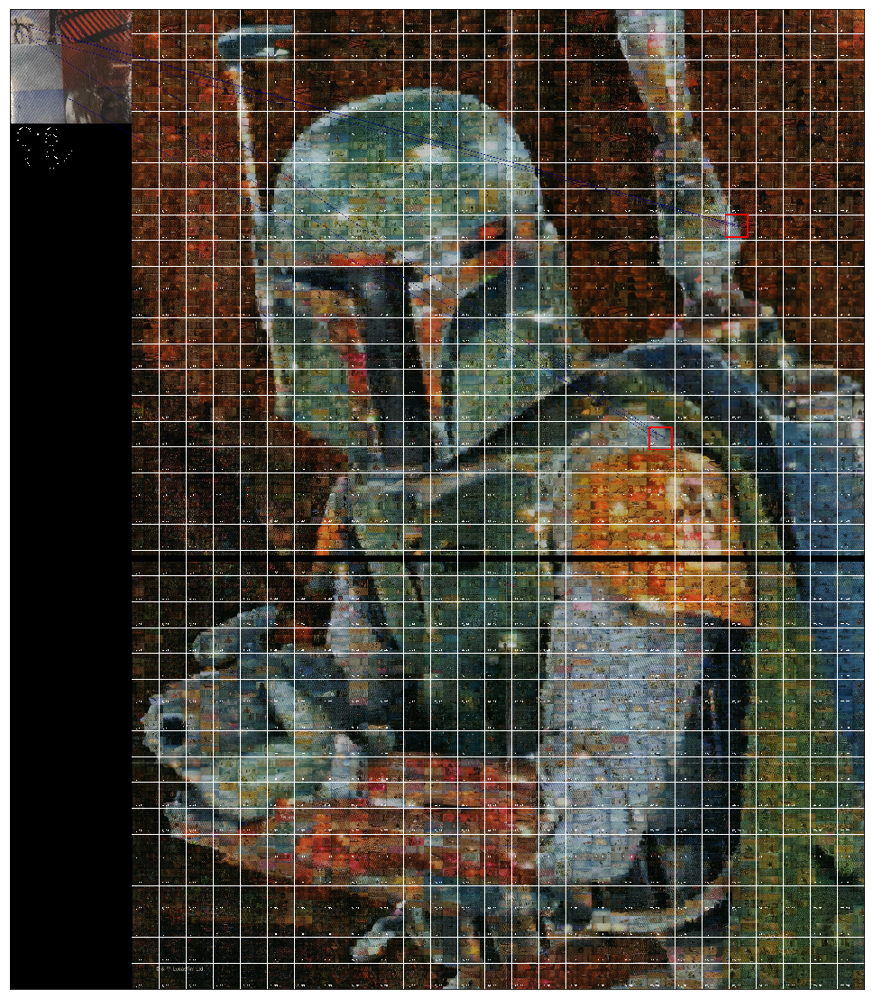

In [12]:
best_image('gap.jpg', 'IMG_0277_inside.jpg')

In the object and scene, found 370 and 41629 keypoints respectively
Got 3 good matching points
Saved IMG_0276_inside_solution.jpg


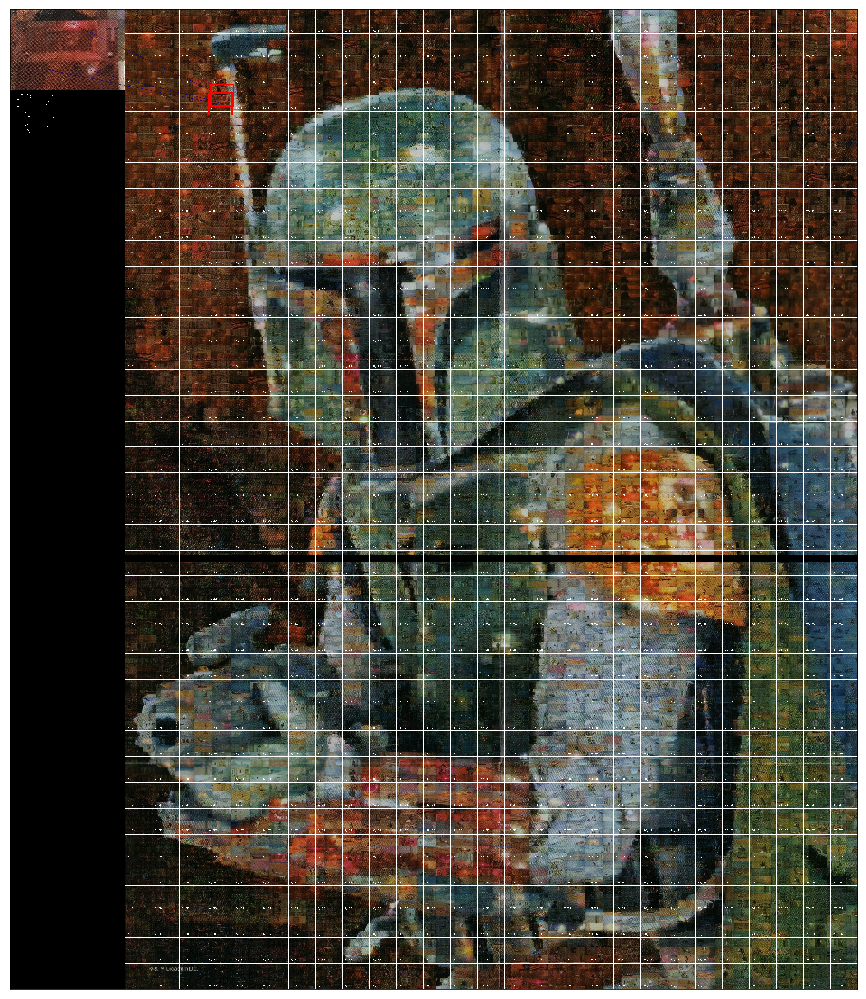

In [13]:
best_image('gap.jpg', 'IMG_0276_inside.png')

In the object and scene, found 173 and 41629 keypoints respectively
Got 6 good matching points
Saved IMG_0286_solution.jpg


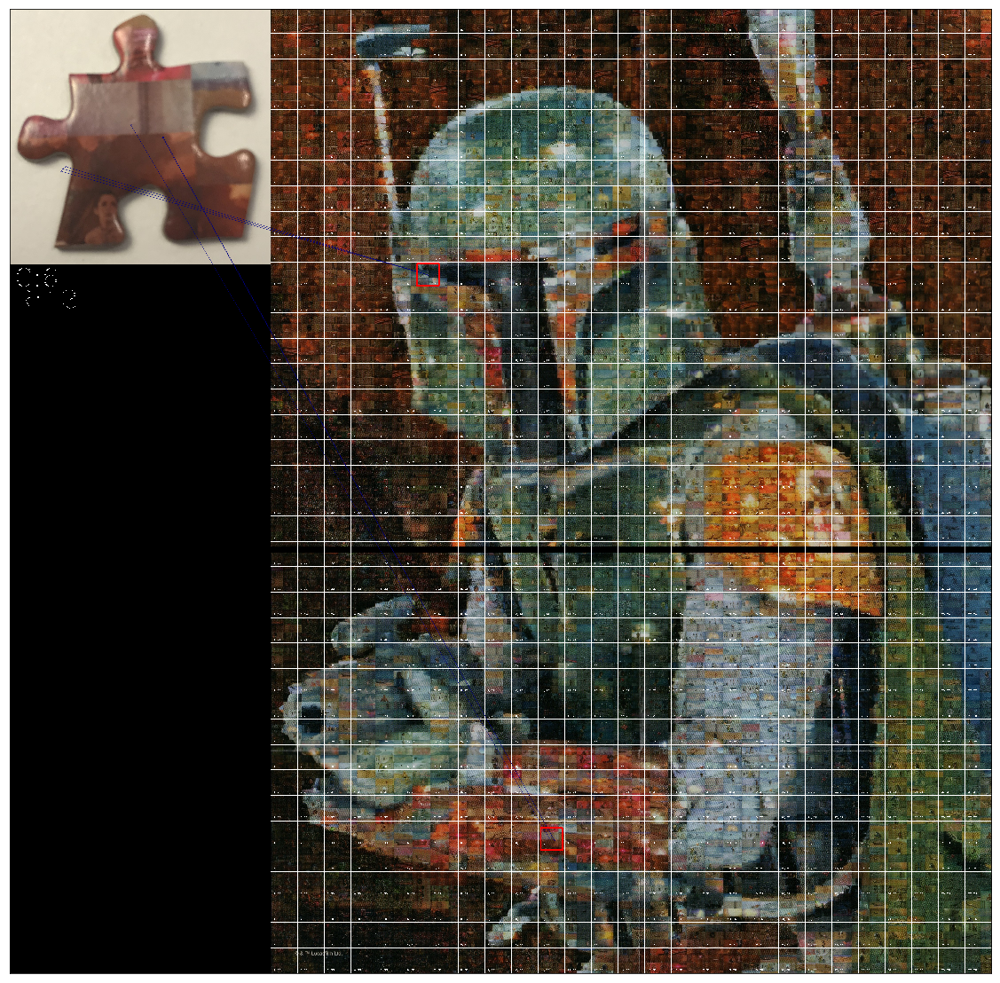

In [14]:
best_image('gap.jpg', 'IMG_0286.jpg')

### These are working great!! 

The solutions are getting 1-3 good locations to find and so far in each, they've been finding the correct locations. In the one where the it wasn't an inside crop, the background was incorrectly matched to other parts of the image but the correct location was still found. The addition of the match clustering seemed to greatly increase the robustness of the algorithm. 

I'd like to move on to the tile slicing method that I also tried implementing and is the backup method to identify possible locations based on similar images. Due to the time it takes to upload and crop images for the above methods, the below can be quicker by just pointing to similar images. 

## Slicing the tiles

Now we have a straightened photo, I need to make sure the individual tiles are evenly spaced but due to the break in the middle where the two scans were merged, this is not valid. I opened the image in a simple image editor and shifted the bottom half down 25 pixels. This cut off a little of the bottom but didn't affect performance. Using the same image editor, I also counted how many pixel were on the left and top before the first tiles so we would only cluster full size tiles. These offsets were 54 pixels on the right and 4 pixels on the top. For the overall width of each cell, I also needed to know the offset on the right and bottom which were 53 and 14 respectively. 
<img src="gap.jpg">

I then overlaid a grid on this to ensure the slices would be valid photos and not slicing through the middle of some which would throw off the clustering later. 

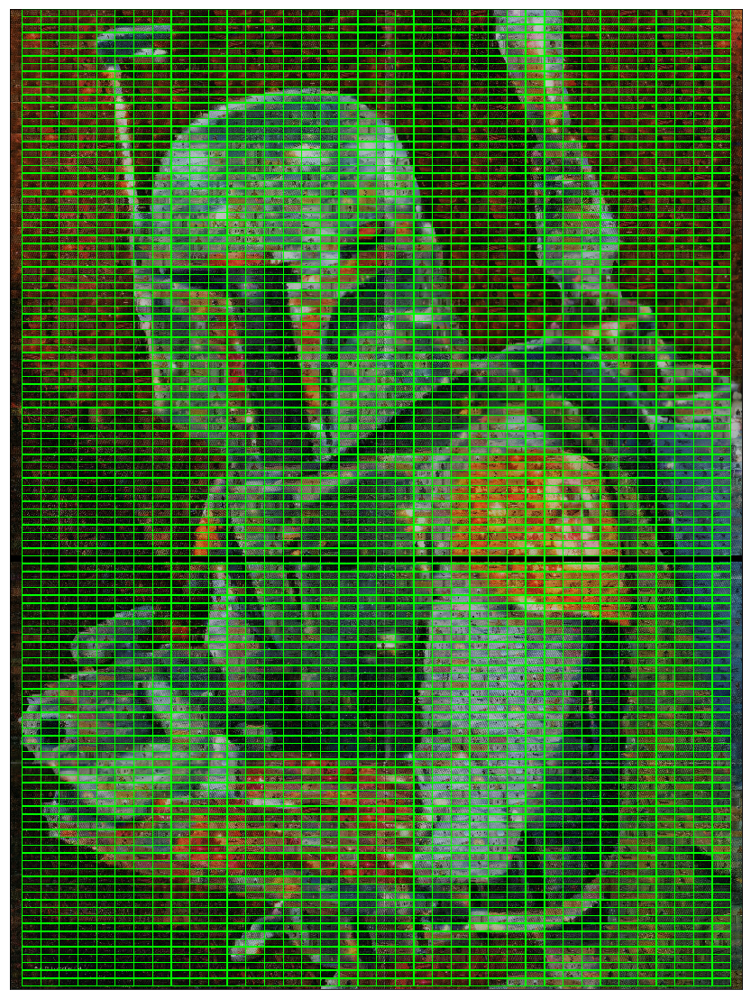

In [15]:
tiles_high = 125 # plus some 
tiles_wide = 38 # plus some
h_offset_left = 54
h_offset_right = 53
v_offset_top = 4
v_offset_bottom = 14

gap = cv.imread('gap.jpg')
gap_test = gap.copy()
high = 125
wide = 38
testv = (gap_test.shape[0]-v_offset_top-v_offset_bottom)/high
testh = (gap_test.shape[1]-h_offset_left-h_offset_right)/wide
for h in range(high):
    for w in range(wide):
        y = int(h*testv)+v_offset_top
        x = int(w*testh)+h_offset_left
        rec_y = int(testv)
        rec_x = int(testh)
        cv.rectangle(gap_test,(x,y), (x+rec_x, y+rec_y), (0,255,0), 4)
cv.imwrite('grid.jpg', gap_test)
plt.figure(figsize = (30, 20))
plt.imshow(gap_test[...,::-1])
plt.xticks([]), plt.yticks([])
plt.show()

Looks like the grid is matching very well with the tiles!

## Clustering the Tiles

The way opencv reads images is it takes the individual pixels and translates the red, green and blue values (actually blue, green, red) into a numpy array of shape (height, width, number_of_color_channels) so by slicing each picture into an equally sized array, we can directly compare them all to each other using a clustering algorithm. In this case, since we're unsure of the number of clusters we're going to need, we'll use the AffinityPropogation clustering algorithm from sklearn to create the clusters. 

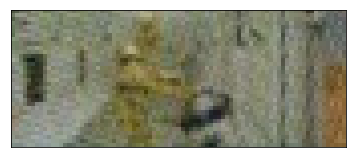

In [16]:
tile_height = (gap.shape[0]-v_offset_top-v_offset_bottom)/tiles_high
tile_width = (gap.shape[1]-h_offset_left-h_offset_right)/tiles_wide
all_tiles = np.ones(((tiles_high*tiles_wide), int(tile_width)*int(tile_height)*3), dtype = int)

#slice out each individual tile

for h in range(tiles_high):
    for w in range(tiles_wide):
        tile_left_edge =round(w*tile_width)+h_offset_left
        tile_top_edge = round(h*tile_height)+v_offset_top
        slice = gap[tile_top_edge:tile_top_edge+int(tile_height), tile_left_edge:tile_left_edge+int(tile_width), :]
        all_tiles[h*tiles_wide+w, :] = slice.flatten()

#Display a random tile
tile_selected_index = 2340

plt.imshow(all_tiles[tile_selected_index,:].reshape((int(tile_height),int(tile_width),3))[...,::-1])
plt.xticks([]), plt.yticks([])
plt.show()

### Hello low-res C3PO and R2D2!

### Actual Clustering
Now that we have the photos, we can start our clustering algorithm! 
This is a reasonably long process, depending on the performance of your computer, it can take a couple minutes. But we only have to run it once! 

In [17]:
tile_clusters = AffinityPropagation().fit(all_tiles)

### How many clusters did we end up with?

In [18]:
len(np.unique(tile_clusters.labels_))

159

### What do some of these clusters of images look like?

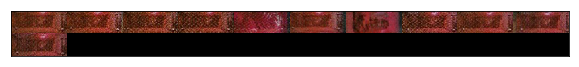

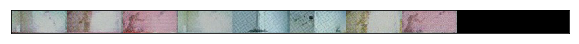

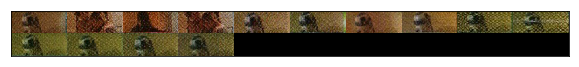

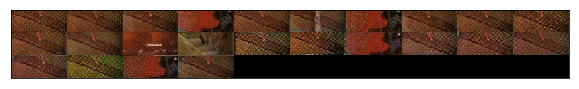

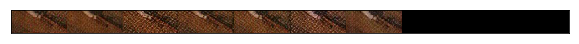

...

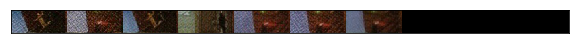

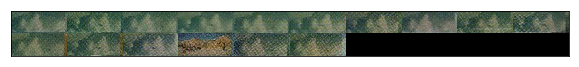

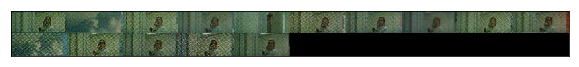

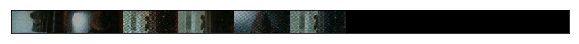

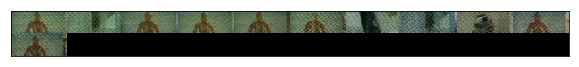

In [19]:
for cluster_index in range(20):
    cluster_tiles = all_tiles[(tile_clusters.labels_ == cluster_index)] # width, height in inches
    num_tiles = len(cluster_tiles)
    output_width = 10
    output_height = int(num_tiles/output_width)+bool(num_tiles%output_width)*1
    output_image = np.zeros((output_height*int(tile_height), output_width*int(tile_width), 3), dtype = int)
    for i in range(num_tiles):
        output_begin_top = int(i/output_width)*int(tile_height)
        output_begin_left = int(i%output_width)*int(tile_width)
        output_image[output_begin_top:output_begin_top+int(tile_height), output_begin_left:output_begin_left+int(tile_width), :] = cluster_tiles[i].reshape((int(tile_height),int(tile_width),3))
    plt.figure(figsize=(10,20))
    plt.imshow(output_image[...,::-1])
    plt.xticks([]), plt.yticks([])
    plt.show()

It appears some of the groups are very well group but others are just more random groupings of images with no intuitive reason for why they were clustered. This will still be very useful though. 

## View matches

Now that we have the clusters, how do find similar images? I wrote a quick tool in opencv that would bind the mouseclicks and this works alright but keeps crashing my python kernal so I'm just running an example for this notebook. 

In [27]:
def get_cluster(x,y):
    """gives cluster label for pictures at tile index x, y"""

    w = x
    h = y
    label = tile_clusters.labels_[h*tiles_wide+w]
    return label

def gc(x,y):
    """When given the pixels from gap.jpg, return the label
    More convenient than trying to lookup the index of photos
    """

    x = int((x-h_offset_left)/tile_width)
    y = int((y-v_offset_top)/tile_height)
    label = get_cluster(x,y)
    return label


def get_matches(match_array):
    """Given an array with indexes, match those indexes are the larger array. 
    
    Parameters: 
    match_array (numpy array): 2D array with index labels in the desired positions and -1 in unknown locations
    """
    shaped_labels = tile_clusters.labels_.reshape(tiles_high, tiles_wide)
    #find partial and full matches. 
    #If you put in three indexes, a partial match will be returned if 2 are present in the orientation given
    exact_points = []
    some_points = []
    
    fill = match_array != -1 # mask for ignoring unknown pictures
    for y in range(shaped_labels.shape[0]-match_array.shape[0]):
        for x in range(shaped_labels.shape[1]-match_array.shape[1]):
            scene_array = shaped_labels[y:y+match_array.shape[0],x:x+match_array.shape[1]]
            match_boolean = match_array[fill] == scene_array[fill]
            if (match_boolean).all():
                exact_points +=[(x, y)]
            if (match_boolean.sum()>= (max(match_boolean.size-1,1))):
                some_points +=[(x,y)]
    print(len(exact_points), ' matched points ', len(some_points)-len(exact_points), ' partials')
    return exact_points, some_points

def draw_match_rectangles(img, match_array = np.ones((1,1), dtype = int)):
    """Draw appropriate rectangles to show where matches and partial matches are.
    
    Parameters: 
    img (numpy array): img that will have the rectangles drawn on it- should be same as was used to cluster original slices
    match_array: 2D array with indexes of desired cells
    """
    exact_points, some_points = get_matches(match_array)
    #good points in green
    for point in some_points:
        y = int(point[1]*tile_height)+v_offset_top
        x = int(point[0]*tile_width)+h_offset_left
        rec_y = int(match_array.shape[0]*tile_height)
        rec_x = int(match_array.shape[1]*tile_width)
        cv.rectangle(img,(x,y), (x+rec_x, y+rec_y), (255,0,0), 4)
    #match except one in blue
    for point in exact_points:
        y = int(point[1]*tile_height)+v_offset_top
        x = int(point[0]*tile_width)+h_offset_left
        rec_y = int(match_array.shape[0]*tile_height)
        rec_x = int(match_array.shape[1]*tile_width)
        cv.rectangle(img,(x,y), (x+rec_x, y+rec_y), (0,255,0), 4)
    cv.imwrite('matches.jpg', img)
    return img


## Performing a lookup

Now that we have these functions, I can open gap.jpg in paint, put the crosshairs on an similar image to what I'm trying to find and see where else it shows up in the puzzle. For instance, I have puzzle piece with R2D2 and a circular window two tiles below it on the **piece**. I found a similar photo of R2D2 in the **helmet** at (924, 1310) and I found a similar circular window in the **glove** at (517,3542) of the puzzle. Feeding those points into the puzzle produces:

28  matched points  0  partials


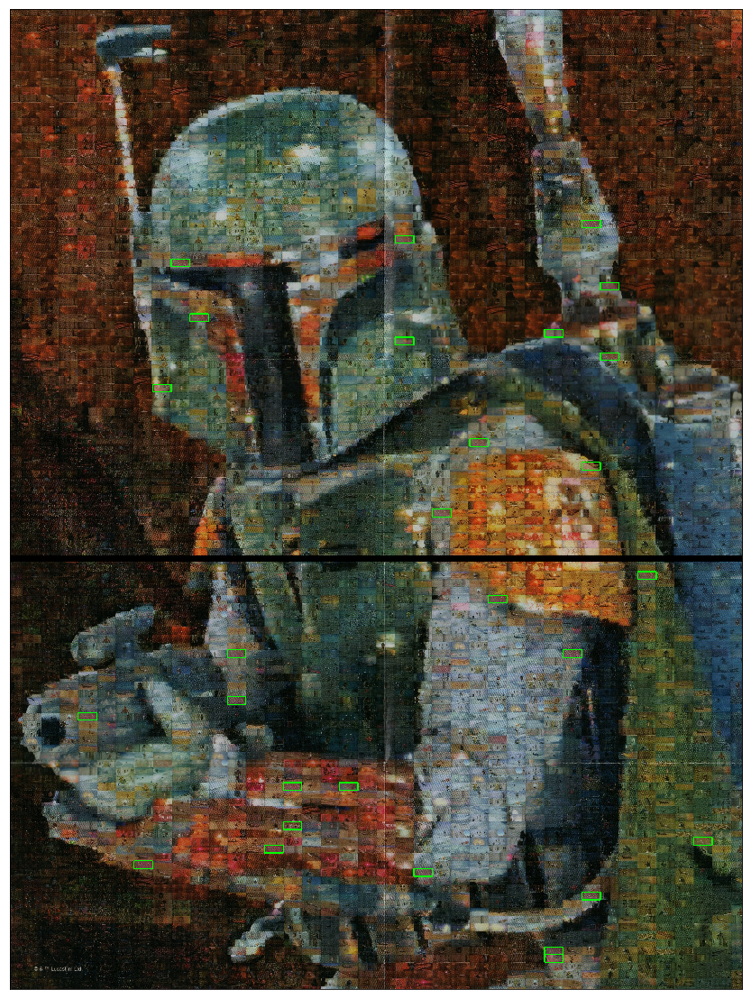

In [36]:
plt.figure(figsize=(30,20)) # 2086,2530
image = draw_match_rectangles(gap.copy(),  np.array([[gc(760,1140)]]))
#cv.drawMarker(image,(924,1310),(0,0,255), markerSize = 100, thickness = 5)
#cv.drawMarker(image,(517,3542),(0,0,255), markerSize = 100, thickness = 5)
plt.imshow(image[...,::-1])
plt.xticks([]), plt.yticks([])
plt.show()

### We found the correct location!

To quicken this process, the below script automates the process of clicking on a part of the photo to get the coordinates and returns the similar photos found. 
However, you can't zoom in to the photo so it's hard to tell if images match. This could be a future functionality. 

This script is meant to be run through command prompt and uses the above lookup functions to show similar photos of any single image clicked. It could be improved by taking in extra arguments for the pictures to apply the functions to. 

In [ ]:
#This script if run through command prompt uses the above lookup functions to show similar photos of any single image clicked.
#It's not as robust as I would like

#%% click and draw

# initialize the list of reference points
refPt = []

#This is meant to be run from the command line

def click_and_draw(event, x, y, flags, param):
    # grab references to the global variables
    global refPt
    # if the left mouse button was clicked, record the starting
    # (x, y) coordinates 
    if event == cv.EVENT_LBUTTONDOWN:
        refPt = [(x, y)]
    # check to see if the left mouse button was released
    elif event == cv.EVENT_LBUTTONUP:
        # record the ending (x, y) coordinates
        #based on where was clicked, perform the lookup
        image = draw_match_rectangles(gap.copy(), np.array([[gc(x,y)]]))
        cv.imshow("image", image)
    return 

# load the image, clone it, and setup the mouse callback function
image = puzzle.copy()
clone = image.copy()
cv.namedWindow("image", cv.WINDOW_NORMAL)
cv.setMouseCallback("image", click_and_draw)
cv.imshow("image", image)
# keep looping until the 'q' key is pressed
while True:
    # display the image and wait for a keypress
    key = cv.waitKey(1) & 0xFF

    # if the 'r' key is pressed, reset the cropping region
    if key == ord("r"):
        image = clone.copy()

    # if the 'c' key is pressed, break from the loop
    elif key == ord("c"):
           break

# close all open windows
cv.destroyAllWindows()

# Final Thoughts

This project was very satisfying to find a technological solution and build on previous work to build a reasonably robust puzzle solving program. It probably could be ported into an actual application since I hear opencv has been brought over to iOS and Android. The main sticking point would be that my most successful run was using the SURF algorithm and given the patent, I'm unsure of if the cost of applying it in an app would be cost effective. Applying the clustering to the end of the photo matching seemed to dramatically boost performance and I'm happy the system seems to be working great. 